<a href="https://colab.research.google.com/github/BeatriceFederici/Heart-Sound-Analysis/blob/master/heartSoundSegmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### **IMPORT LIBRARIES AND MODULES**





In [ ]:
import os                       # filesystem utils
import matplotlib.pyplot as plt # plot graphs
from scipy.io import wavfile    # read .WAV files
from scipy import signal        # signal processing
import numpy as np              # manage arrays
import IPython.display          # play sounds
import tensorflow as tf
from tensorflow import keras

### **DRIVE FILES MANAGEMENT**

In [ ]:
from google.colab import drive  # drive files management
drive.mount('/content/drive', force_remount=True)
NORMAL_DATA_PATH_B      = 'drive/My Drive/neuroengineering/Group_4/Data/Challenge/Training B Normal'
NORMAL_TEST_SEG_PATH_B  = 'drive/My Drive/neuroengineering/Group_4/Data/Challenge/Btest_normal_seg.csv'
NORMAL_TRAIN_SEG_PATH_B = 'drive/My Drive/neuroengineering/Group_4/Data/Challenge/Btraining_normal_seg.csv'


Mounted at /content/drive


### **LOAD SEGMENTATIONS DATA**

In [ ]:
table = [] # table initialization

# Function to read the data from a segmentation file and add it to the variable "table"
def read_data (path):
  global table # This allows us to edit the content of the variable "table" instead of creating a new one
  if not os.path.exists(path):
    print("Missing file: {}", path)
    return
  
  with open(path, "r") as f:
    content = f.read() # Read .CSV file content

  # Split table by rows
  for row in content.split("\n")[1:]: # skip header row (salto riga 0)
    # Skip missing rows
    if row == '':
      continue
    # Split row by columns to get samples
    samples = row.split(",")
    # Remove missing data at end of row
    for last in range(len(samples)-1, -1, -1):
      if samples[last] != '': # Found data, stop
        break
    else: # All data are missing
      continue
    samples = samples[:last+1]
    # Replace remaining missing data with np.nan
    samples = [sample if sample != "" else np.nan for sample in samples]
    if len(samples) % 2 != 1: # odd number of sounds
      samples.append(np.nan) # add missing data for missing sound
    table.append(samples)

read_data(NORMAL_TRAIN_SEG_PATH_B)
read_data(NORMAL_TEST_SEG_PATH_B)

segmentations = {       # dictionary : ID e poi seguono S1 e S2 a coppie
  row[0].split(".")[0] : # Use first column as ID (removing extension)
    np.array(row[1:], dtype=float).reshape(-1,2) # Convert to a Nx2 matrix
  for row in table
}

name_list = []  # list containing names of segmentated recordings to use as a reference
for recording in segmentations:
  name_list.append(recording)

name_list_train = name_list[ : 90]
name_list_test = name_list[90 : ]

### **EXTRACT DATA FROM .WAV FILES - (FS = 4 kHz)**

In [ ]:
def catch_file(name_file):  # function that extract raw data from corresponding .wav file 
  filename = "{}.wav".format(name_file)
  filename_B = os.path.join(NORMAL_DATA_PATH_B, filename)

  # Read data and sample rate from .WAV file
  if os.path.exists(filename_B):
    fs, data = wavfile.read(filename_B)
  else:
    print("Missing recording: {}".format(name_file))
  return data
  
data_train_old_sampling = []  # list that contains all raw training signals
data_test_old_sampling = []  # list that contains all raw test signals

for i in range(len(name_list_train)):
  data_train_old_sampling.append(catch_file(name_list_train[i]))

for i in range(len(name_list_test)):
  data_test_old_sampling.append(catch_file(name_list_test[i]))

print(len(data_train_old_sampling))
print(len(data_test_old_sampling))

90
29


### **PLOT DATA**

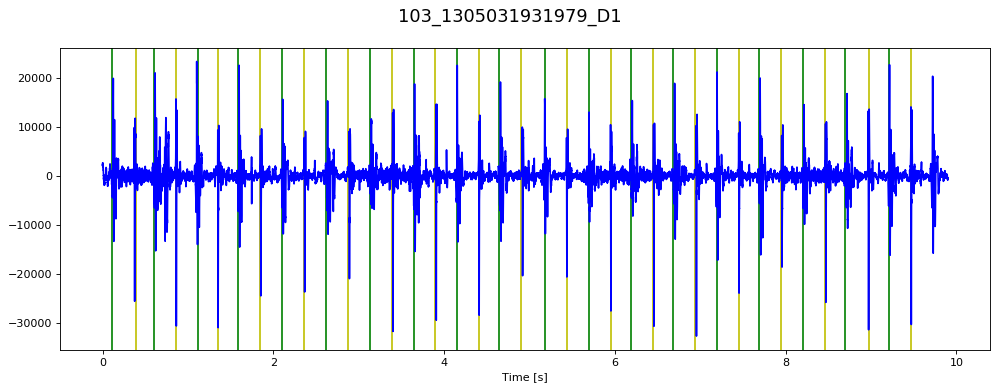

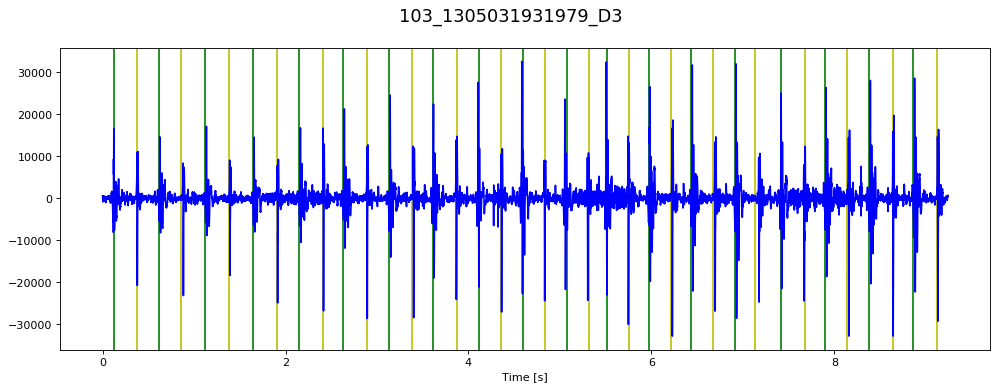

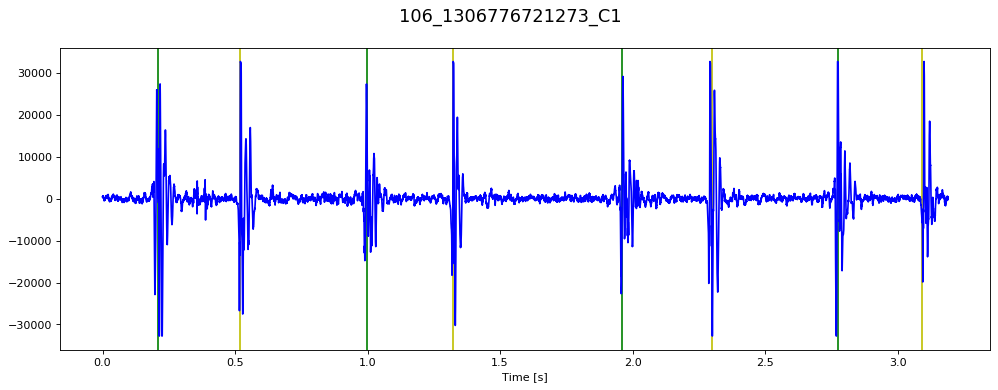

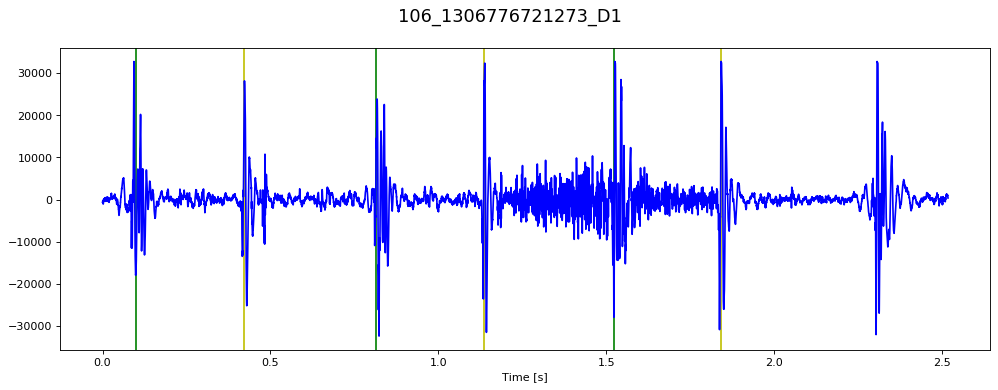

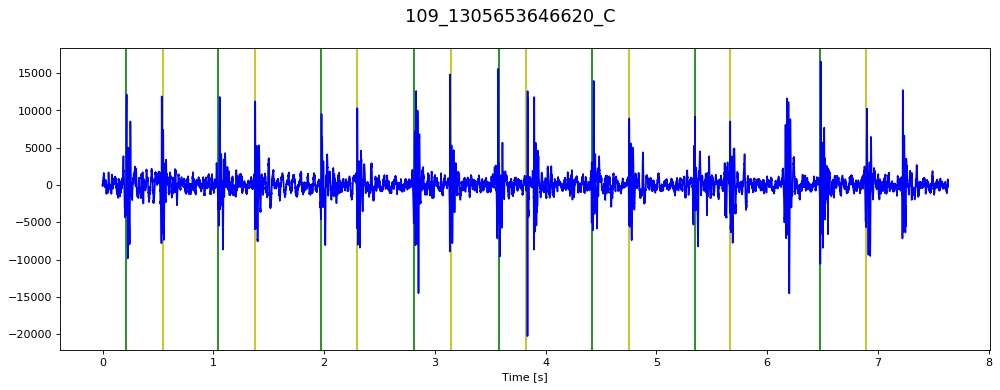

...

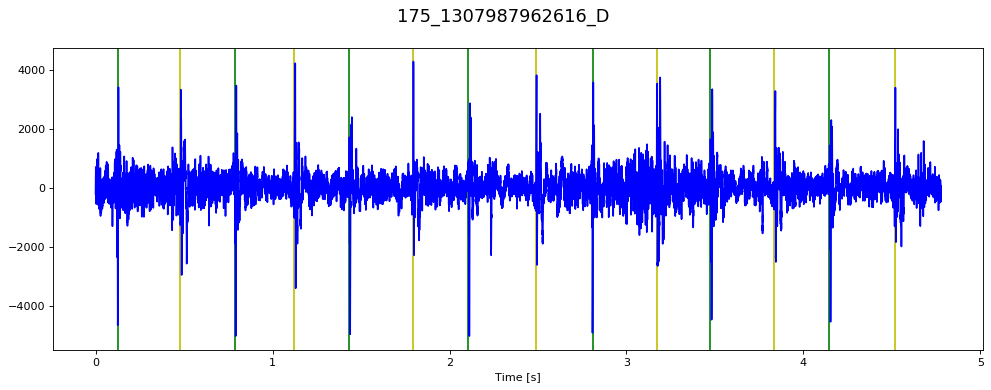

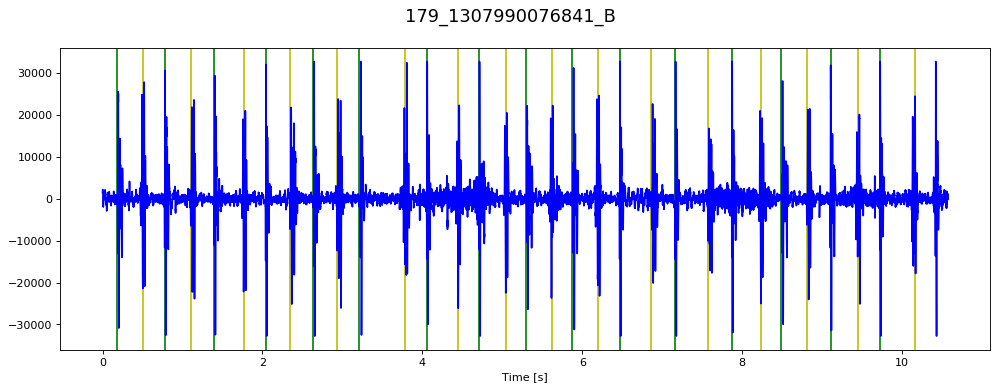

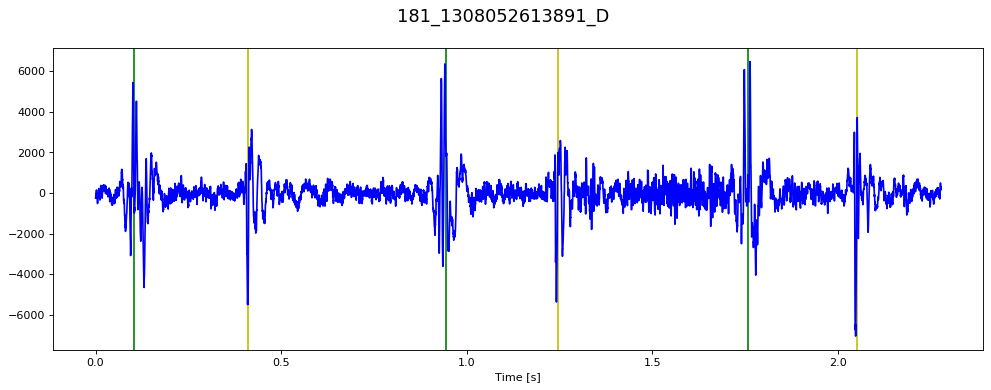

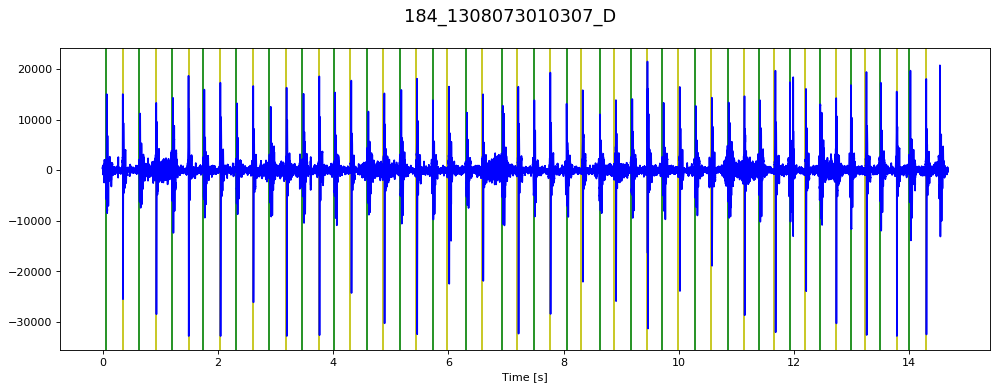

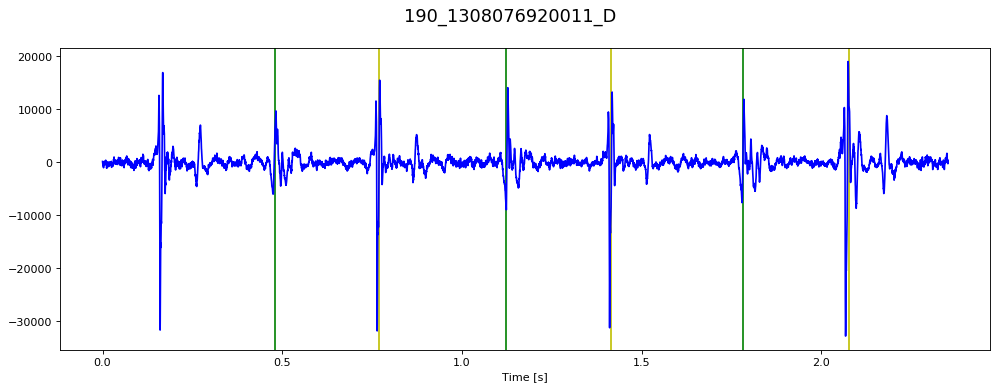

In [ ]:
fs_old = 4000
f_Nyquist_old = 2000 

# plot training signals
for i in range(len(name_list_train)):
  fig = plt.figure(figsize=(15,5), dpi= 80, facecolor='w', edgecolor='k') # title each signal with its recording name 
  times = np.arange(len(data_train_old_sampling[i])) / fs_old  # times vector generation 
  for s1, s2 in segmentations[name_list_train[i]]:
    if not np.isnan(s1) and not np.isnan(s2): # if nan is present don't plot on the graph
      fig.suptitle(name_list_train[i], fontsize=16)
      plt.xlabel('Time [s]')
      plt.axvline(s1 / fs_old, color='g', alpha=1)  # plot s1 events
      plt.axvline(s2 / fs_old, color='y', alpha=1)  # plot s2 events 
  plt.plot(times, data_train_old_sampling[i], 'b-') # plotting training signals after resampling
  plt.show()
  IPython.display.display(IPython.display.Audio(data_train_old_sampling[i], rate=fs_old, autoplay=False)) # plot audio

# plot test signals
for i in range(len(name_list_test)):
  fig = plt.figure(figsize=(15,5), dpi= 80, facecolor='w', edgecolor='k') # title each signal with its recording name 
  times = np.arange(len(data_test_old_sampling[i])) / fs_old  # times vector generation 
  for s1, s2 in segmentations[name_list_test[i]]:
    if not np.isnan(s1) and not np.isnan(s2): # if nan is present don't plot on the graph
      fig.suptitle(name_list_test[i], fontsize=16)
      plt.xlabel('Time [s]')
      plt.axvline(s1 / fs_old, color='g', alpha=1)  # plot s1 events
      plt.axvline(s2 / fs_old, color='y', alpha=1)  # plot s2 events 
  plt.plot(times, data_test_old_sampling[i], 'b-') # plotting training signals after resampling
  plt.show()
  IPython.display.display(IPython.display.Audio(data_test_old_sampling[i], rate=fs_old, autoplay=False)) # plot audio


### **1.DATA PREPROCESSING**





In [ ]:
'''
Data preprocessing is structered as follow:
- BANDAPASS BUTTERWORTH FILTER (ORDER 3)
- ENVELOPE
- DATA RESAMPLING
- REMOVE NOISY PARTS
- NORMALIZATION
'''

'\nData preprocessing is structered as follow:\n- BANDAPASS BUTTERWORTH FILTER (ORDER 3)\n- ENVELOPE\n- DATA RESAMPLING\n- REMOVE NOISY PARTS\n- NORMALIZATION\n'

### **FILTERING SIGNALS USING BANDPASS BUTTERWORTH FILTER (ORDER = 3)**

In [ ]:
fs_old = 4000
f_Nyquist_old = 2000 
f1 = 25
f2 = 400
order = 3
w1= f1 / f_Nyquist_old  # f1 bandpass
w2= f2 / f_Nyquist_old  # f2 bandpass
band = [w1, w2]
b, a= signal.butter(order, band, 'bandpass')  # Butterworth filter

for i in range(len(data_train_old_sampling)):
  data_train_old_sampling[i]= signal.filtfilt(b, a, data_train_old_sampling[i]) # filtering each raw training signal using filter coefficients

for i in range(len(data_test_old_sampling)):
  data_test_old_sampling[i]= signal.filtfilt(b, a, data_test_old_sampling[i]) # filtering each raw test signal using filter coefficients

### **ENVELOPE**

In [ ]:
#### train signals ####
for i in range(len(data_train_old_sampling)): 
  data_train_old_sampling[i] = abs(data_train_old_sampling[i])  # training signal rectification  
  
f_cut = 50  # envelope low pass filter
order = 2
b, a= signal.butter(order, f_cut / f_Nyquist_old, 'lowpass')  # Butterworth filter

for i in range(len(data_train_old_sampling)):
  data_train_old_sampling[i]= signal.filtfilt(b, a, data_train_old_sampling[i]) # filtering each raw training signal using filter coefficients

#### test signals ####
for i in range(len(data_test_old_sampling)): 
  data_test_old_sampling[i] = abs(data_test_old_sampling[i])  # test signal rectification  
  
f_cut = 50  # envelope low pass filter
order = 2
b, a= signal.butter(order, f_cut / f_Nyquist_old, 'lowpass')  # Butterworth filter

for i in range(len(data_test_old_sampling)):
  data_test_old_sampling[i]= signal.filtfilt(b, a, data_test_old_sampling[i]) # filtering each raw test signal using filter coefficients

### **DATA RESAMPLING (FS = 200 Hz)**

In [ ]:
downsampling_factor = 20
fs_new = 200 
f_Nyquist_new = 100

#### training ####
data_train_new_sampling = []  # list that contains new signals after resampling
print(len(data_train_old_sampling[0]))
for i in range(len(data_train_old_sampling)):
  data_train_new_sampling.append(signal.decimate(data_train_old_sampling[i], downsampling_factor))  # decimate function reduce sampling frequency from 4 kHz to 400 Hz
print(len(data_train_new_sampling[0]))

#### test ####
data_test_new_sampling=[]  # list that contains new signals after resampling
print(len(data_test_old_sampling[0]))
for i in range(len(data_test_old_sampling)):
  data_test_new_sampling.append(signal.decimate(data_test_old_sampling[i], downsampling_factor))  # decimate function reduce sampling frequency from 4 kHz to 400 Hz
print(len(data_test_new_sampling[0]))

39610
1981
24839
1242


### **REMOVE NOISY PARTS OF SIGNALS** 

In [ ]:
''' 
Since the signals present usually noise at the extremities, we decided to cut the records 50 samples 
before the first S1 and 50 samples after the last S2. In case there were less than 50 samples before the 
first S1 or after the last S2, we kept all the recording. 
'''

#### training ####
s1_start_list_train = []  # list that contains first s1 event postion [in samples] for each signal 
samples_interval = 50  # number of samples kept before first s1 event and after last s2 event (0.125 seconds)
for i in range(len(name_list_train)):
  s1_start_train, s2_start_train = segmentations[name_list_train[i]][0] # extraction of the first s1,s2 couple of i-th ID
  s1_end_train, s2_end_train = segmentations[name_list_train[i]][-1]    # extraction of the last s1,s2 couple of i-th ID
  
  if np.isnan(s1_start_train): # if first s1 is nan skip to next couple s1,s2
    s1_start_train, s2_start_train = segmentations[name_list_train[i]][1] 
    
  if np.isnan(s2_end_train): # if last s2 is nan go back to previous s1,s2 
    s1_end_train, s2_end_train = segmentations[name_list_train[i]][-2]    
    
  s1_start_train = s1_start_train / downsampling_factor   # s1_start resampling according to downsampling factor
  s1_start_list_train.append(s1_start_train)              # list that contains all first resampled s1 events 
  s2_start_train = s2_start_train / downsampling_factor   # s2_start resampling 
  s1_end_train = s1_end_train / downsampling_factor       # s1_end resampling
  s2_end_train = s2_end_train / downsampling_factor       # s2_end resampling

  # take 50 samples before first s1 event and after last s2 event, use max to keep 50 or less samples if the signal is shorter  
  data_train_new_sampling[i] = data_train_new_sampling[i][max(int(s1_start_train) - samples_interval , 0) : int(s2_end_train) + samples_interval]    


#### test ####
s1_start_list_test = []  # list that contains first s1 event postion [in samples] for each signal 
samples_interval = 50  # samples to keep before first s1 event and after last s2 event. (0.125 seconds)
for i in range(len(name_list_test)):
  s1_start_test, s2_start_test = segmentations[name_list_test[i]][0] # extraction of the first s1,s2 couple of i-th ID
  s1_end_test, s2_end_test = segmentations[name_list_test[i]][-1]    # extraction of the last s1,s2 couple of i-th ID 
  
  if np.isnan(s1_start_test): # if first s1 is nan skip to next couple s1,s2
    s1_start_test, s2_start_test = segmentations[name_list_test[i]][1] 
    
  if np.isnan(s2_end_test): # if last s2 is nan go back to previous s1,s2 
    s1_end_test, s2_end_test = segmentations[name_list_test[i]][-2]    
    
  s1_start_test = s1_start_test / downsampling_factor   # s1_start resampling
  s1_start_list_test.append(s1_start_test)              # list that contains all first resampled s1 events 
  s2_start_test = s2_start_test / downsampling_factor   # s2_start resampling 
  s1_end_test = s1_end_test / downsampling_factor       # s1_end resampling
  s2_end_test = s2_end_test / downsampling_factor       # s2_end resampling

  # take 50 samples before first s1 event and after last s2 event, se max to keep 50 or less samples if the signal is shorter  
  data_test_new_sampling[i] = data_test_new_sampling[i][max(int(s1_start_test) - samples_interval , 0) : int(s2_end_test) + samples_interval]    

### **PLOT NORMALIZED DATA AFTER PREPROCESSING**

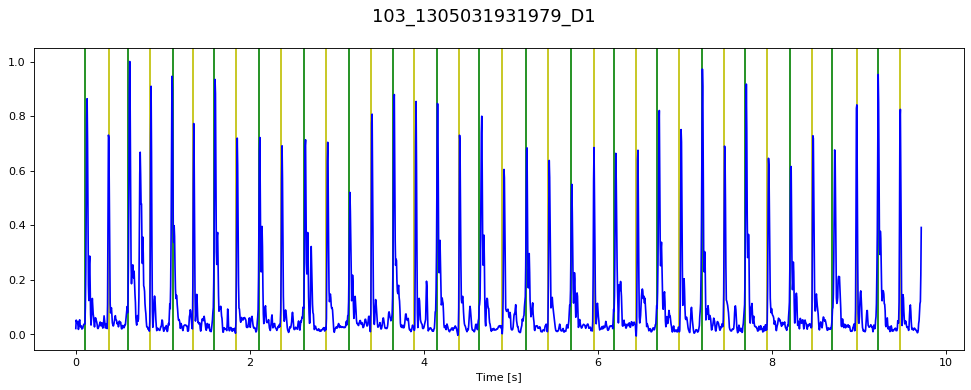

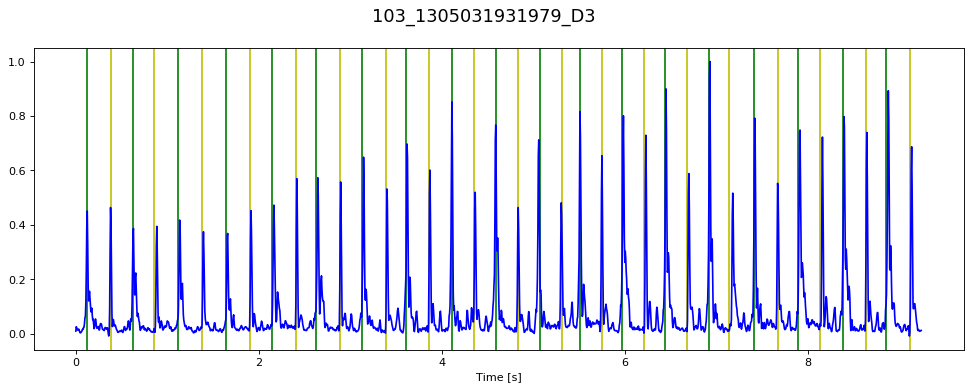

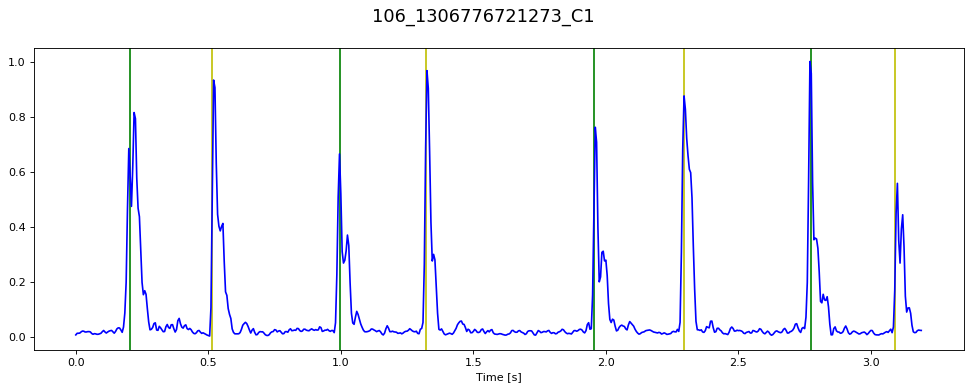

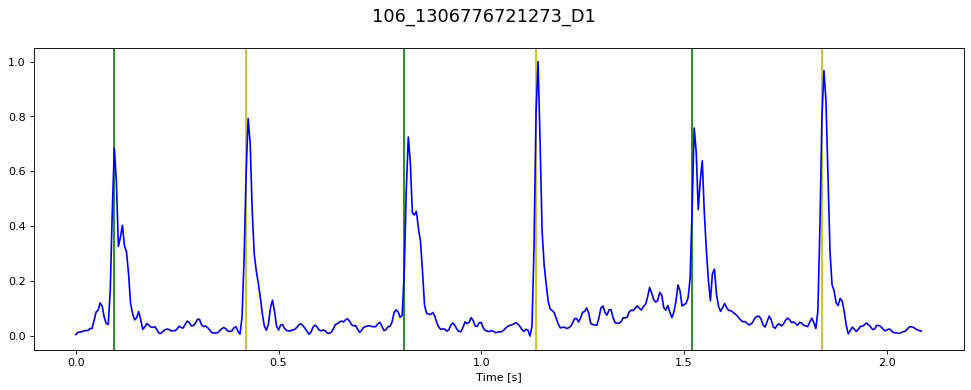

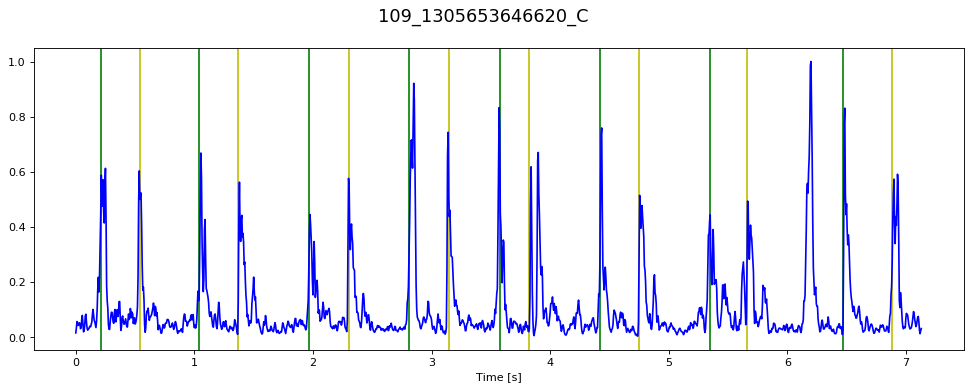

...

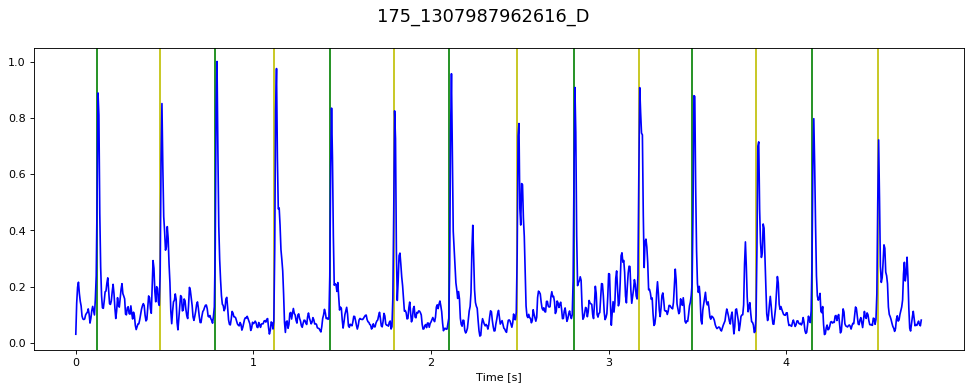

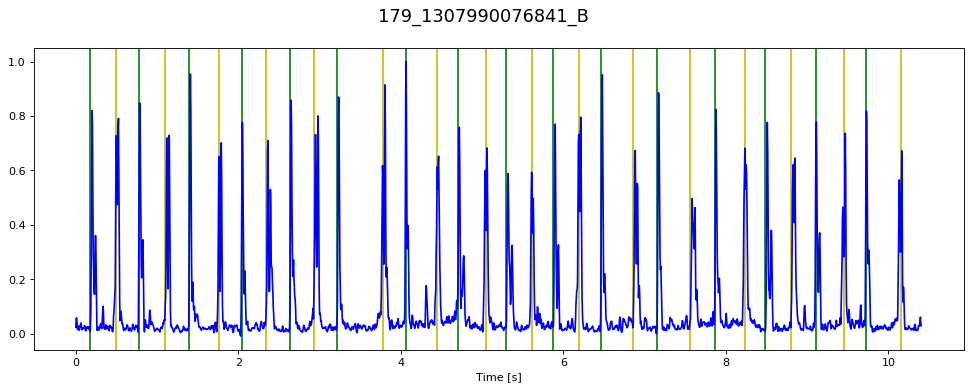

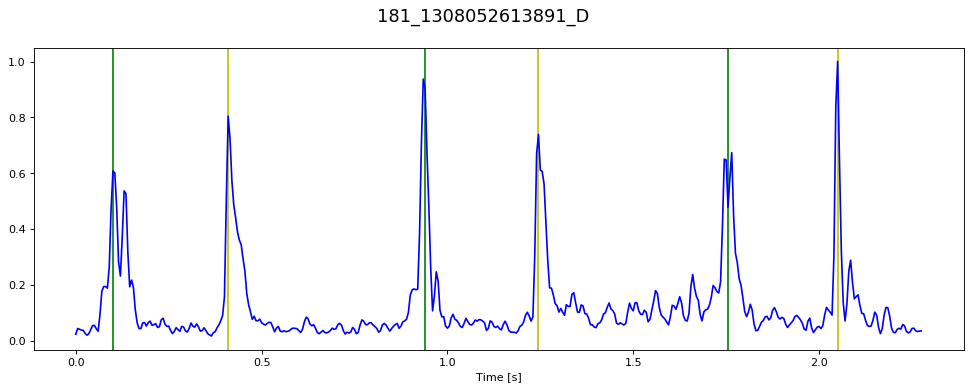

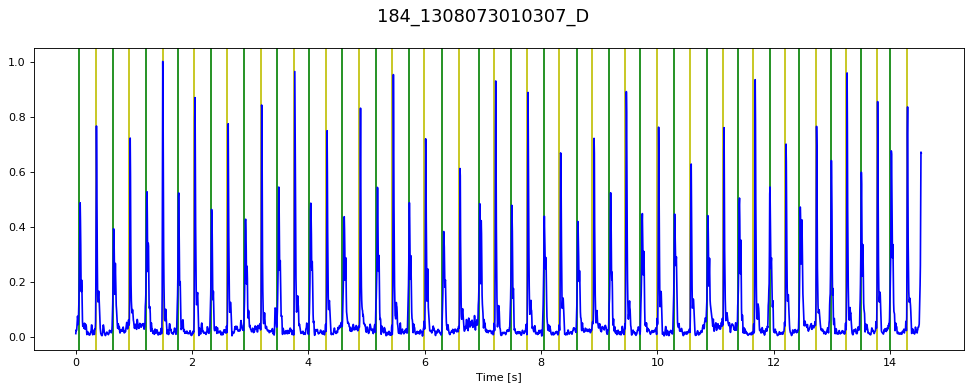

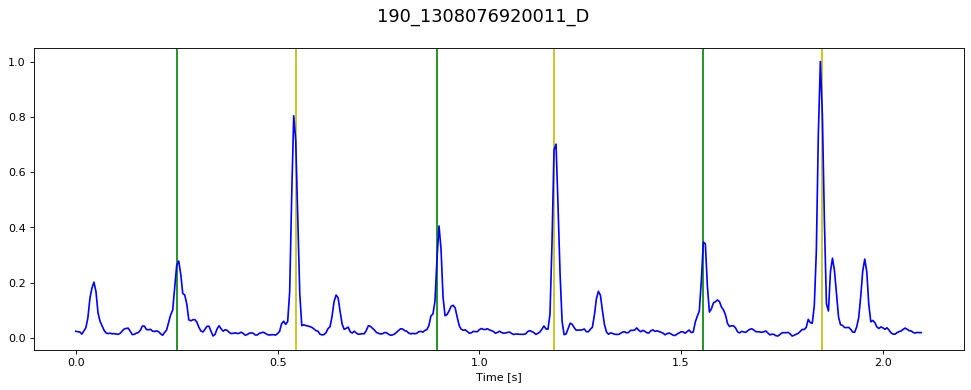

In [ ]:
#### training ####
for i in range(len(name_list_train)):
  data_train_new_sampling[i] = data_train_new_sampling[i]/max(data_train_new_sampling[i])  #normalization
  fig = plt.figure(figsize=(15,5), dpi= 80, facecolor='w', edgecolor='k')
  times = np.arange(len(data_train_new_sampling[i])) / fs_new
  for s1, s2 in segmentations[name_list_train[i]]:
    if not np.isnan(s1) and not np.isnan(s2):
      fig.suptitle(name_list_train[i], fontsize=16)
      plt.xlabel('Time [s]')
      plt.axvline((int(s1 / downsampling_factor) - max(int(s1_start_list_train[i]) - samples_interval , 0)) / fs_new, color='g', alpha=1)  # plot s1 events shifted after signal processing
      plt.axvline((int(s2 / downsampling_factor) - max(int(s1_start_list_train[i]) - samples_interval , 0)) / fs_new, color='y', alpha=1)  # plot s2 events shifted after signal processing
  plt.plot(times, data_train_new_sampling[i], 'b-')
  plt.show()

#### test ####
for i in range(len(name_list_test)):
  data_test_new_sampling[i] = data_test_new_sampling[i]/max(data_test_new_sampling[i]) #normalization 
  fig = plt.figure(figsize=(15,5), dpi= 80, facecolor='w', edgecolor='k')
  times = np.arange(len(data_test_new_sampling[i])) / fs_new
  for s1, s2 in segmentations[name_list_test[i]]:
    if not np.isnan(s1) and not np.isnan(s2):
      fig.suptitle(name_list_test[i], fontsize=16)
      plt.xlabel('Time [s]')
      plt.axvline((int(s1 / downsampling_factor) - max(int(s1_start_list_test[i]) - samples_interval , 0)) / fs_new, color='g', alpha=1)  # plot s1 events shifted after signal processing
      plt.axvline((int(s2 / downsampling_factor) - max(int(s1_start_list_test[i]) - samples_interval , 0)) / fs_new, color='y', alpha=1)  # plot s2 events shifted after signal processing
  plt.plot(times, data_test_new_sampling[i], 'b-')
  plt.show()

### **2. LABELS CREATION**

In [ ]:
'''
Since it is known that S1 is the sound between diastole and systole, and S2 is the sound between systole and diastole, 
we decided to divide the recordings into two types of intervals: one for systole (1) and one for diastole (0). 
In this way, one class was sufficient. Basically, to create the label vectors, we create a vector of zeros for each signal and update each element 
according to  given s1, s2 couples
'''

CLASSES = ["Intervals"] # the code is easily modifiable for multiple classes
NUM_CLASSES = len(CLASSES)

#### training ####
outputs_train = []

for i in range(len(name_list_train)): 
  events_train = segmentations[name_list_train[i]] # extract the s1, s2 couples of the signal with i-th ID
  sample_size_train = len(data_train_new_sampling[i]) # number of samples of the signal with i-th ID

  labels_train = np.zeros((sample_size_train, NUM_CLASSES)) # create a vector of zeros with the same length of the signal
  labels_train[: , CLASSES.index("Intervals")] = 0 # initialize the rows belonging to the class "Intervals" (in this case all) at 0 
   
  for s1, s2 in events_train:
    if not np.isnan(s1) and not np.isnan(s2):
      # since the given s1 (s2) is the index of a specific sample we need to move it according to the cutting of the signal (done before)
      s1= int(s1/downsampling_factor  - max(int(s1_start_list_train[i]) - samples_interval , 0)) 
      s2= int(s2/downsampling_factor - max(int(s1_start_list_train[i]) - samples_interval , 0)) 
      for k in range(s2-s1):
        labels_train[(s1+k) , CLASSES.index("Intervals")] = 1  # set at 1 the intervals between s1 and s2        
  outputs_train.append(labels_train)

targets_train = np.array(outputs_train) # Make outputs multidimensional numpy arrays = labels conversion

#### test ####
outputs_test = []

for i in range(len(name_list_test)): 
  events_test = segmentations[name_list_test[i]]
  sample_size_test= len(data_test_new_sampling[i])

  labels_test = np.zeros((sample_size_test, NUM_CLASSES))
  labels_test[: , CLASSES.index("Intervals")] = 0 # initialize all intervals at 0 
   
  for s1, s2 in events_test:
    if not np.isnan(s1) and not np.isnan(s2):
      # since the given s1 (s2) is the index of a specific sample we need to move it according to the cutting of the signal (done before)
      s1= int(s1/downsampling_factor  - max(int(s1_start_list_test[i]) - samples_interval , 0))
      s2= int(s2/downsampling_factor - max(int(s1_start_list_test[i]) - samples_interval , 0))
      for k in range(s2-s1):
        labels_test[(s1+k) , CLASSES.index("Intervals")] = 1 # set 1 the intervals between s1 and s2        
  outputs_test.append(labels_test)

targets_test = np.array(outputs_test) # Make outputs multidimensional numpy arrays = labels conversion


### **3. DATA PROCESSING**

In [ ]:
'''
Data processing is structured as follow:
- NEURAL NETWORK GENERATION
- METRICS DEFINITION
- PARAMETERS EVALUATION (the best input_size, filter_size, shift)
- GENERATION OF THE TEST DATASET
- MODEL FIT AND EVALUATION
'''

'\nData processing is structured as follow:\n- NEURAL NETWORK GENERATION\n- METRICS DEFINITION\n- PARAMETERS EVALUATION (the best input_size, filter_size, shift)\n- GENERATION OF THE TEST DATASET\n- MODEL FIT AND EVALUATION\n'

### **NEURAL NETWORK**

In [ ]:
'''
According to literature we decided to implent a simplified U-Net NN, based on the principle of encoding and decoding the information. 
After few trials we deleted the skip connections, since they didn't give any improvement.
'''

def rete(input_size, filter_size):
  input_vector = keras.layers.Input(shape=(input_size,1))  # adapt this if using `channels_first` image data format
  # dimension = N       block: Conv + ReLu      features maps: 4
  x1 = keras.layers.Conv1D(4, filter_size, activation='tanh', padding='same')(input_vector) 
  x2 = keras.layers.ReLU()(x1)

  x3 = keras.layers.MaxPooling1D(2, padding='same')(x2) 

  #dimension = N/2      block: Conv + ReLu      features maps: 8 
  x4= keras.layers.Conv1D(8, filter_size, activation='tanh', padding='same')(x3)
  x5= keras.layers.ReLU()(x4)

  x6 = keras.layers.MaxPooling1D(2, padding='same')(x5)

  #dimension = N/4      block: Conv + ReLu      features maps: 16
  x7 = keras.layers.Conv1D(16, filter_size, activation='tanh', padding='same')(x6)
  x8 = keras.layers.ReLU()(x7)

  x9 = keras.layers.MaxPooling1D(2, padding='same')(x8)

  #dimension = N/8      block: Conv + ReLu      features maps: 32
  x10 = keras.layers.Conv1D(32, filter_size, activation='tanh', padding='same')(x9)  
  x11 = keras.layers.ReLU()(x10)
    
  y = keras.layers.UpSampling1D(2)(x11)

  #dimension = N/4      block: Conv + ReLu      features maps: 16
  y1= keras.layers.Conv1D(16, filter_size, activation='tanh', padding='same')(y)
  y2 = keras.layers.ReLU()(y1)

  y3= keras.layers.UpSampling1D(2)(y2)

  #dimension = N/2      block: Conv + ReLu      features maps: 8
  y4=keras.layers.Conv1D(8, filter_size, activation='tanh', padding='same')(y3)
  y5=keras.layers.ReLU()(y4)

  y6 = keras.layers.UpSampling1D(2)(y5)
  
  #dimension = N/2      block: Conv + ReLu      features maps: 4
  y7= keras.layers.Conv1D(4, filter_size, activation='tanh', padding='same')(y6)
  y8= keras.layers.ReLU()(y7)

  #dimension = N/2      block: Conv             features map: 1       
  y_out=keras.layers.Conv1D(1,filter_size,activation='sigmoid', padding='same' )(y8)
  return keras.Model(input_vector, y_out)
  


### **METRICS DEFINITION**

In [ ]:
''' 
According to literature, we implemented the dice coefficient and the Dice_Loss_Function. At the end, it came out that 
this loss function was not the best. Thus, we decided to move to the already implemented Binary_Cross_Entropy 
'''

def dice_coef(y_true, y_pred, smooth=1):                # definition of dice coefficient - a common metric for segmentation tasks in signal processing
    intersection = keras.backend.sum(y_true * y_pred)
    return (2. * intersection + smooth) / (keras.backend.sum(y_true) + keras.backend.sum(y_pred) + smooth)

def dice_coef_loss(y_true, y_pred):                     # loss funztion definition based on the dice coefficient
    return 1-dice_coef(y_true, y_pred)





### **PARAMETERS EVALUATION**

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
{'400;3;50': 0.5920383}
{'400;3;50': 0.5920383, '400;3;100': 0.60752153}
{'400;3;50': 0.5920383, '400;3;100': 0.60752153, '400;3;400': 0.60992646}
{'400;3;50': 0.5920383, '400;3;100': 0.60752153, '400;3;400': 0.60992646, '400;30;50': 0.6566329}
{'400;3;50': 0.5920383, '400;3;100': 0.60752153, '400;3;400': 0.60992646, '400;30;50': 0.6566329, '400;30;100': 0.6746983}
{'400;3;50': 0.5920383, '400;3;100': 0.60752153, '400;3;400': 0.60992646, '400;30;50': 0.6566329, '400;30;100': 0.6746983, '400;30;400': 0.7079412}
{'400;3;50': 0.5920383, '400;3;100': 0.60752153, '400;3;400': 0.60992646, '400;30;50': 0.6566329, '400;30;100': 0.6746983, '400;30;400': 0.7079412, '400;100;50': 0.7101914}
{'400;3;50': 0.5920383, '400;3;100': 0.60752153, '400;3;400': 0.60992646, '400;30;50': 0.6566329, '400;30;100': 0.6746983, '400;30;400':

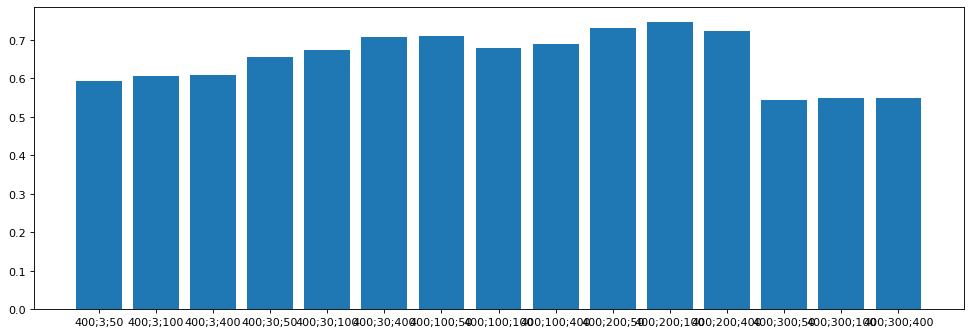

In [ ]:
''' 
In order to define the length N of the input_size, as well as the filter_size and the shift value, we repeated the process 
with the different combination of these parameters and extract the ones that have the best performance in terms of validation_accuracy. 
At the end, we saved the best model to recall it later with the test_dataset.
'''
# range of possible value for the filter_size
# range of possible value for the input_size (multiple of 8, according to the architecture of the NN)
 # range of possible value for the shift, the shift equals to input_size means no overlap
list_accuracy={}
list_model={}
for input_size in [400]: 
  for filter_size in [3, 30, 100, 200, 300]: 
    model = rete(input_size, filter_size)
    model.compile(optimizer=tf.train.AdamOptimizer(),
                  loss='binary_crossentropy', 
                  metrics=[dice_coef, 'accuracy'])
    for shift in [50, 100, input_size]:
      lista_data_train = []
      lista_label_train= []
      for i in range(len(name_list_train)):
        for k in range((len(data_train_new_sampling[i])-input_size+shift)//shift): # iterate over the number of windows obtained with a specific shift
          z=shift*k
          lista_data_train.append(data_train_new_sampling[i][z:input_size+z]) # extract from data_train_new_sampling the segments of length input_size
          lista_label_train.append(targets_train[i][z:input_size+z]) # extract from targets_train the segments of length input_size
      
      lista_data_train = np.asarray(lista_data_train)  # transform into numpy array 
      lista_label_train = np.asarray(lista_label_train) # transform into numpy array
      lista_data_train = np.expand_dims(lista_data_train, axis=2) # expand the dimensionality of lista_data_train 
      
      # create the training dataset (80%) and the validation dataset (20%)
      training_data = []
      training_labels = []
      validation_data = []
      validation_labels = []
      for i in range(len(lista_data_train)):
        if i < 0.8*len(lista_data_train):
          training_data.append(lista_data_train[i])
        else:
          validation_data.append(lista_data_train[i])

      for i in range(len(lista_label_train)):
        if i < 0.8*len(lista_label_train):
          training_labels.append(lista_label_train[i])
        else:
          validation_labels.append(lista_label_train[i])
        
      training_data = np.asarray(training_data)
      training_labels = np.asarray (training_labels)
      validation_data = np.asarray(validation_data)
      validation_labels = np.asarray (validation_labels)
      
      # train every single model and saving its parameters and the last validation accuracy for each one
      history = model.fit(training_data, training_labels, batch_size = 50 , epochs = 5 , validation_data=(validation_data, validation_labels), verbose = 0)
      header=str(input_size)+";"+str(filter_size)+";"+str(shift)   # each element will be named 'input_Size,filter_size,shift'
      list_accuracy[header]= history.history['val_acc'][-1]
      print(list_accuracy)
      list_model[header]=model

# barplot: on x axis the different combination of (input_size, filter_size, shift); on y axis the accuracy on validation set
fig = plt.figure(figsize=(15,5), dpi= 80, facecolor='w', edgecolor='k')
x = np.arange(len(list_accuracy))
y = list_accuracy.values()
plt.bar(x, y)
plt.xticks(x, list_accuracy.keys())
plt.show()


### **GENERATION TEST DATASET**

In [ ]:
'''
Once we had selected the best parameters from the code before, we proceded using them to divide properly the test dataset with the found input_size
'''

top= max(list_accuracy, key=list_accuracy.get)    #select the best combination of input_size, filter_size, shift and save the respective ID string in top
input_size= int(top.split(";")[0])                #split the string into the variables of inerest
filter_size=int(top.split(";")[1])
shift= int(top.split(";")[2])
# generate the dataset to suit the best parameters chosen before
lista_data_test = []
lista_label_test = []
for i in range(len(name_list_test)):
  for k in range(int(len(data_test_new_sampling[i])/input_size)): 
    lista_data_test.append(data_test_new_sampling[i][input_size*k:input_size*(k+1)])
    lista_label_test.append(targets_test[i][input_size*k:input_size*(k+1)])


lista_data_test = np.asarray(lista_data_test)
lista_label_test = np.asarray(lista_label_test)
print(lista_data_test.shape)
print(lista_label_test.shape)
lista_data_test = np.expand_dims(lista_data_test, axis=2)
lista_label_test = lista_label_test.reshape(-1, input_size)
print(lista_data_test.shape)
print(lista_label_test.shape)


(55, 400)
(55, 400, 1)
(55, 400, 1)
(55, 400)


### **MODEL FIT ON TESTSET**

In [ ]:
'''CNN predictions on dataset'''
 
model = list_model[top]
prediction = model.predict(lista_data_test)
print(model.evaluate(validation_data, validation_labels))       # print the results in terms of dice_coef and accuracy obtained on validation dataset
print(model.evaluate(lista_data_test, np.expand_dims(lista_label_test, axis=2)))      # print the results in terms of dice_coef and accuracy  obtained on test dataset

### **5.DATA VISUALIZATION**

### **COMPARISON BETWEEN PREDICTIONS AND LABELS**

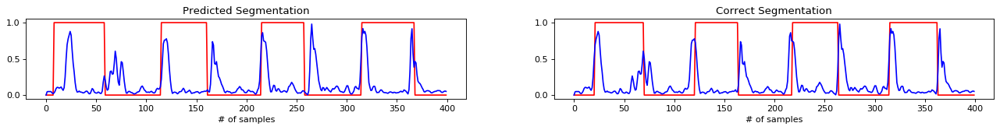

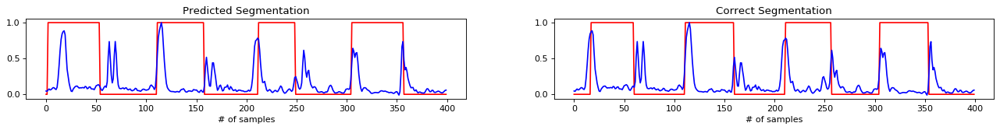

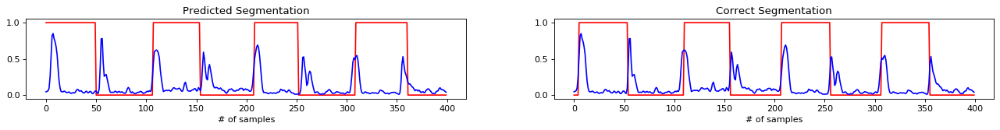

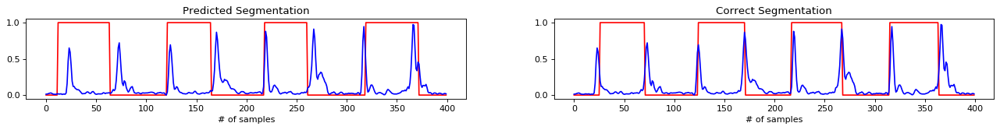

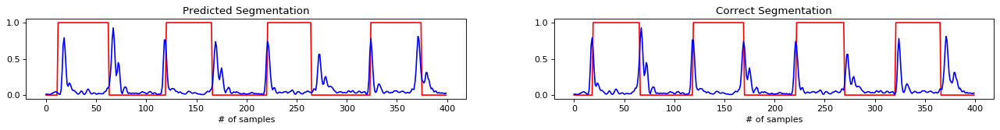

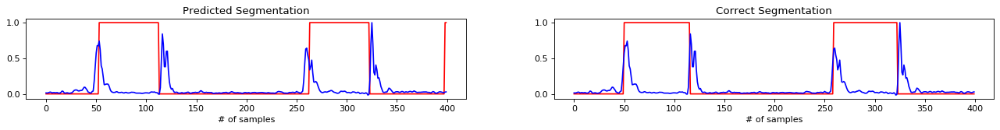

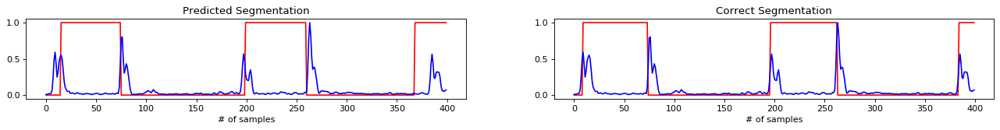

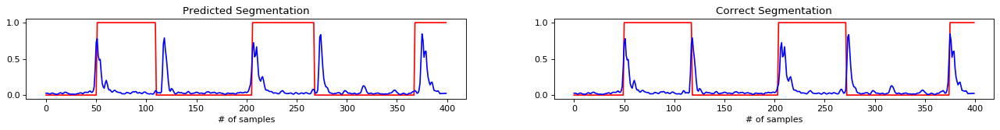

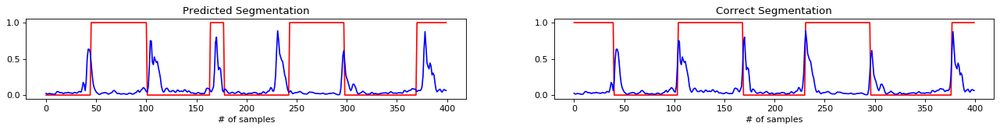

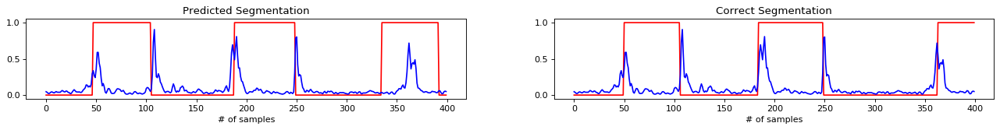

In [ ]:
''' 
Vsualization of each single output of the net superimposed on the signal in 
order to check the accuracy of the segmentation. On th right side the correct prediction is also plotted for comparison.
''' 

for k in range(len(prediction)):            # thresholding the output at 0.5, to get class 0 and class 1
  for i in range(len(prediction[k])):
    if prediction[k][i] >= 0.5:
      prediction[k][i]=1
    else:
      prediction[k][i]=0

for k in range(10):         # plot only 10 examples of prediction results
  fig = plt.figure(figsize=(20,20), dpi= 80, facecolor='w', edgecolor='k')
  plt.subplot(10,2,2*k+1)    
  plt.title('Predicted Segmentation')
  plt.xlabel('# of samples')
  plt.plot(range(len(prediction[k])), prediction[k], 'r-')  
  plt.plot(range(len(prediction[k])), lista_data_test[k], 'b-')
  #plt.show()
  plt.subplot(10,2,2*k+2)
  plt.title('Correct Segmentation')
  plt.xlabel('# of samples')
  plt.plot(range(len(lista_label_test[k])), lista_label_test[k][0 : input_size], 'r-')
  plt.plot(range(len(lista_data_test[k])), lista_data_test[k], 'b-')  
  plt.show()

### **VISUALIZATION OF THE WHOLE SIGNALS**

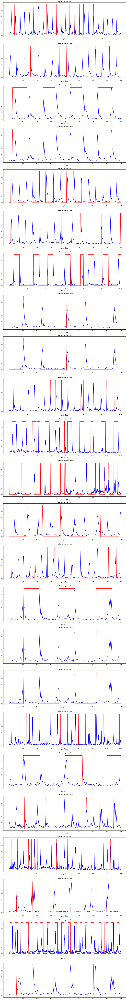

In [ ]:
'''
For each sound reconstruct the signal and the output label in their entire length concatenating each slice of dimensions as the input_size of the CNN. 
Then, plot the whoe signal with the predictions. The prediction still present only two classes: class 1 (systole), class 0 (diastole). 
Noticeable, the plot present few errors always in proximity of the conjunction point (at multiple of input_size), underlying a weakness of this procedure.
'''

prediction_table = []
data_table =[]
pos = 0
k = 0
for i in range(len(name_list_test)):
  prediction_row = 0
  data_row = 0
  pos = pos + k
  if len(data_test_new_sampling[i])<input_size:       # since some signals might be long less than the input_size (selected automatically), we need to exclude them from the visualization because there is no prediction for these data
    continue
  else:
    for k in range(len(data_test_new_sampling[i])//input_size):
      prediction_row = np.concatenate((prediction_row, prediction[pos+k]), axis = None)
      data_row = np.concatenate((data_row, lista_data_test[pos+k]), axis = None)
    prediction_table.append(prediction_row)
    data_table.append(data_row)



fig = plt.figure(figsize=(20,200), dpi= 80, facecolor='w', edgecolor='k')
for i in range(len(prediction_table)): 
  x_axis = range(0,len(prediction_table[i]))
  plt.title('Predicted Segmentation')
  plt.xlabel('# of samples')
  plt.subplot(29,1,i+1)
  plt.plot(x_axis, data_table[i], 'b')
  plt.plot(x_axis, prediction_table[i], 'r-')






### **TRANSFORM THE OUTPUT TO GET THREE POSSIBLE CLASSES**

{'103_1305031931979_B': [[9, 60], [116, 162], [216, 259], [316, 369], [403, 455], [512, 559], [613, 650], [706, 758], [801, 851], [908, 955], [1009, 1053], [1110, 1162]], '103_1305031931979_D2': [[1, 51], [108, 155], [209, 253], [310, 362], [413, 465], [522, 566], [619, 662], [720, 773]], '106_1306776721273_B1': [[13, 65], [122, 166], [219, 262], [320, 373]], '106_1306776721273_C2': [[13, 65], [122, 166], [219, 262], [320, 373]], '106_1306776721273_D2': [[13, 65], [122, 166], [219, 262], [320, 373], [413, 464], [521, 567], [622, 666], [725, 776]], '107_1305654946865_C1': [[13, 64], [121, 167], [222, 266], [325, 376], [454, 514], [664, 724]], '126_1306777102824_B': [[54, 114], [264, 324], [399, 401], [416, 476], [600, 661], [769, 801], [852, 911], [1007, 1069]], '126_1306777102824_C': [[52, 111], [207, 269]], '133_1306759619127_A': [[52, 111], [207, 269]], '134_1306428161797_C2': [[52, 111], [207, 269], [369, 401], [446, 502], [565, 579], [644, 699], [771, 801], [848, 906], [989, 1050],

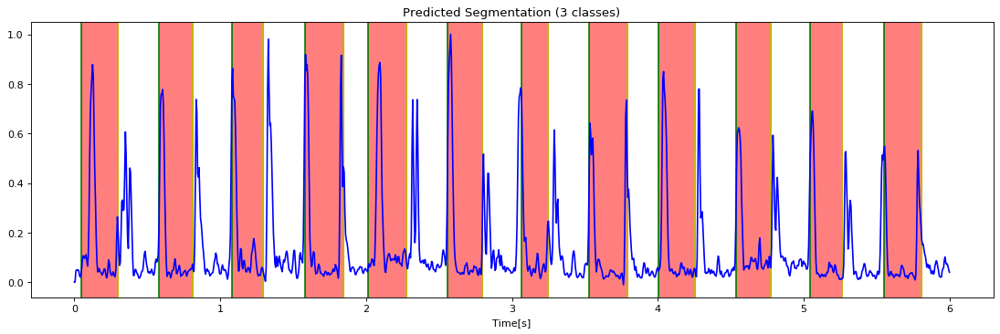

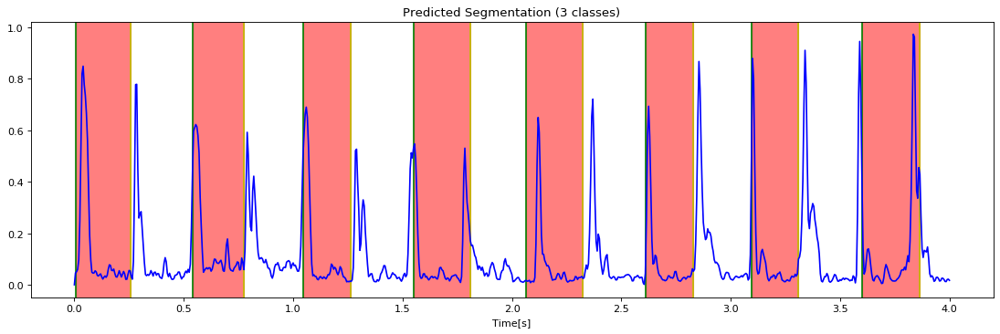

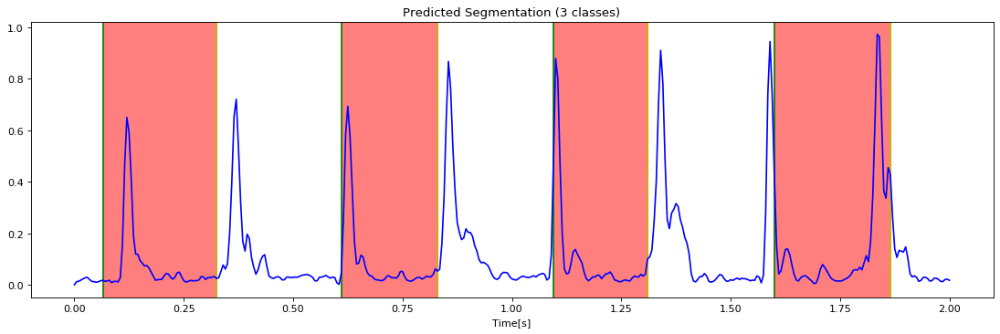

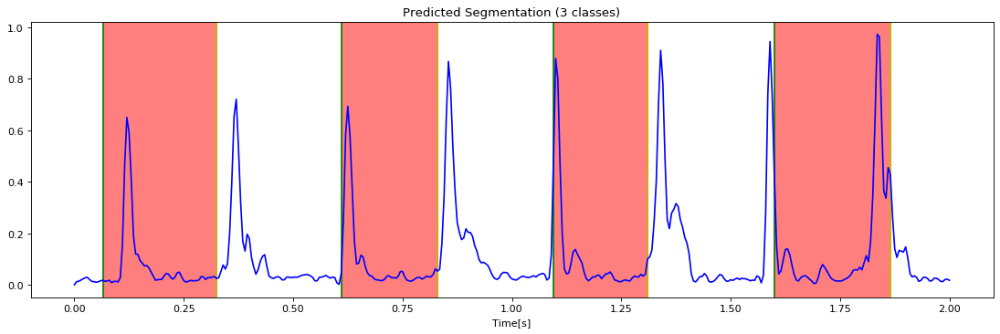

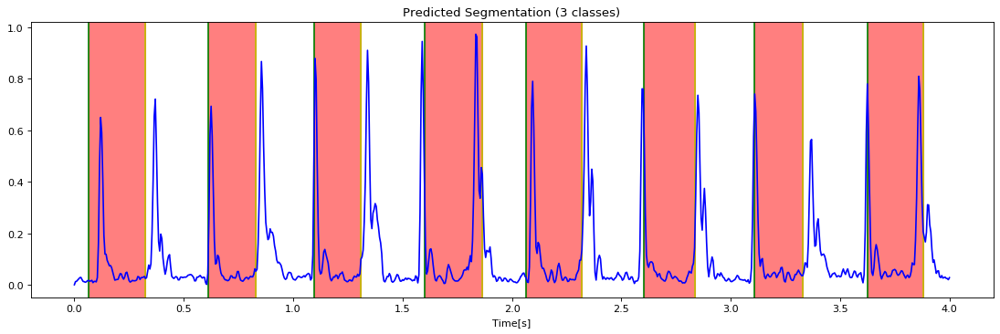

...

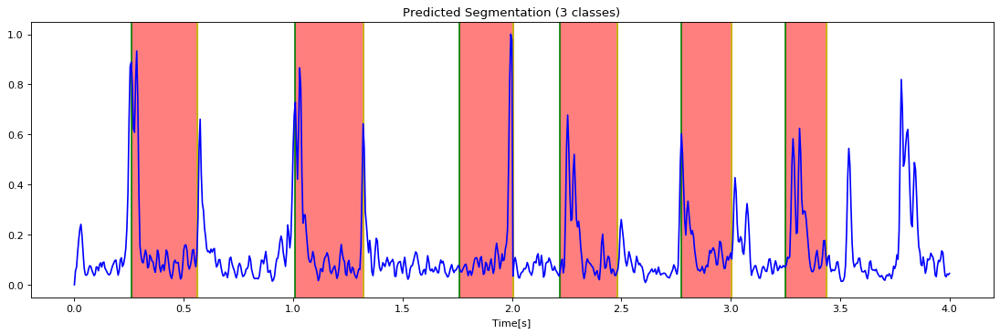

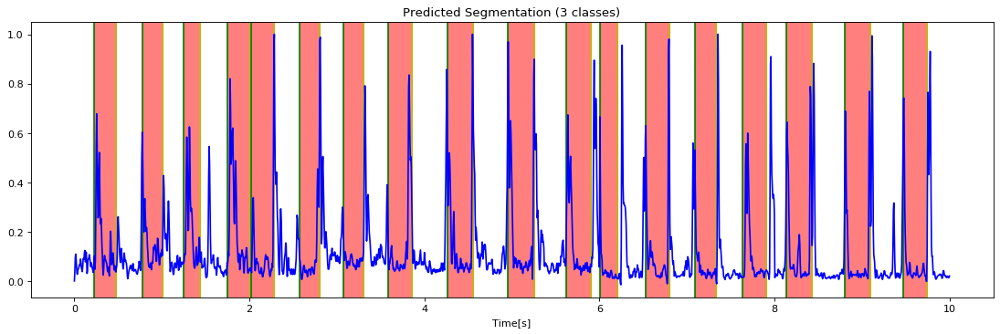

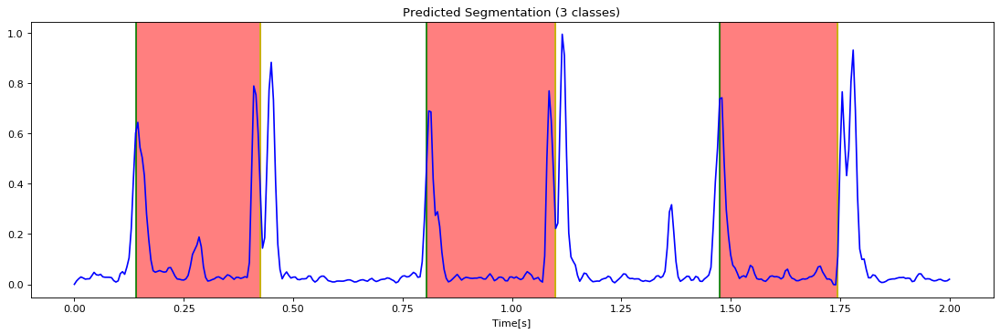

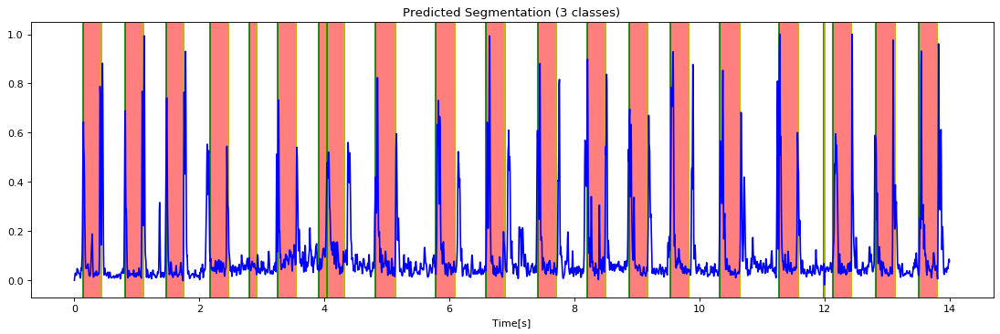

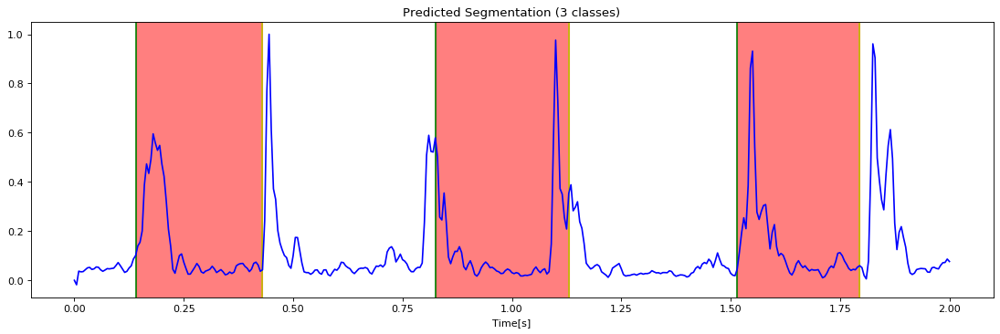

In [ ]:
'''
Lastly, the output is labelled with three different classes S1, S2, and silence, to respond to the requirements given in the guidelines. 
The intervals S1-S2 are plotted on each signal.
'''

flag = 0                # use of flag variable to update the state and identify the point in wich the labels change
s1= float("nan")
s2= float("nan")
couple=[]
predicted_segmentations = {}
for i in range(len(prediction_table)):
  flag = prediction_table[i][0] 
  for k in range(len(prediction_table[i])):       
    if flag == 0 and prediction_table[i][k] == 1:         # if the value of prediction was 0 until k and at k it goes up at 1, it means that the systole is starting, thus k-instant represents S1 heart sound 
      s1 = k
      flag=1   
    elif flag == 1 and prediction_table[i][k] == 0:       # if the value of prediction was 1 until k and at k it goes down to 0, it means that the diastole is starting, thus k-instant represents S2 heart sound 
      s2 = k
      couple.append([s1,s2])
      flag=0
    else:
      continue
    
  predicted_segmentations[name_list_test[i]]= couple
  couple = []  
  
print(predicted_segmentations)

for i in range(len(prediction_table)):
  times = np.arange(len(data_table[i]))/fs_new
  fig = plt.figure(figsize=(17,5), dpi= 80, facecolor='w', edgecolor='k')
  for S1, S2 in predicted_segmentations[name_list_test[i]]:
    plt.title('Predicted Segmentation (3 classes)')
    plt.xlabel('Time[s]')
    plt.axvspan(S1/fs_new, S2/fs_new, color='r', alpha=0.5)
    plt.axvline(S1/fs_new, color='g', alpha=1)
    plt.axvline(S2/fs_new, color='y', alpha=1)
  plt.plot(times, data_table[i], 'b-')
  plt.show()

In [ ]:
model.summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 400, 1)]          0         
_________________________________________________________________
conv1d_24 (Conv1D)           (None, 400, 4)            804       
_________________________________________________________________
re_lu_21 (ReLU)              (None, 400, 4)            0         
_________________________________________________________________
max_pooling1d_9 (MaxPooling1 (None, 200, 4)            0         
_________________________________________________________________
conv1d_25 (Conv1D)           (None, 200, 8)            6408      
_________________________________________________________________
re_lu_22 (ReLU)              (None, 200, 8)            0         
_________________________________________________________________
max_pooling1d_10 (MaxPooling (None, 100, 8)            0   